In [ ]:
# %%
# Import necessary libraries
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, calinski_harabasz_score
import matplotlib.pyplot as plt
import seaborn as sns
from mpl_toolkits.mplot3d import Axes3D  # Necessary for 3D plotting
import os
import datetime
import joblib

dataset_path = "/Users/book_kuno/Desktop/ddos_datasets/2018.csv"  # Update as needed


In [ ]:
# # ---------------------------
# # Parameters and Setup
# # ---------------------------
# # %% [markdown]
# # ## Parameter Definition
# # You can later inject these parameters via Papermill if desired.
# dataset_path = "/Users/book_kuno/Desktop/ddos_datasets/2018.csv"  # Update path as needed
# sample_fraction = 0.05  # Use 1 for 100% of data (change to e.g., 0.05 for 5%)
# run_name = "k-means-100percent"  # Change as desired
# year = "2018"
# model = "kmeans"  # Change as desired

# # Define output folder and create it
# output_folder = os.path.join("Outputs", year, model, run_name)
# os.makedirs(output_folder, exist_ok=True)
# print("Output folder created:", output_folder)

# # %% [markdown]
# # ## Parameter Definition
# # You can later inject these parameters via Papermill if desired.
# dataset_path = "/Users/book_kuno/Desktop/ddos_datasets/2018.csv"  # Update path as needed
# sample_fraction = 0.05  # Use 1 for 100% of data (change to e.g., 0.05 for 5%)
# run_name = "logreg_run1-100percent"  # Change as desired
# year = "2018"
# model = "logreg"  # Change as desired

# # Define output folder and create it if needed
# output_folder = os.path.join("Outputs", year, model, run_name)
# os.makedirs(output_folder, exist_ok=True)
# print("Output folder created:", output_folder)

import os

# 1. Parameters and Setup
dataset_path = "/Users/book_kuno/Desktop/ddos_datasets/2018.csv"  # Update path as needed
sample_fraction = 0.005  # Use 1 for 100% of data (change to e.g., 0.05 for 5%)
run_name = "k-means_run1-100percent"  # Change as desired
model = "k-means"  # Change as desired

# Extract the entire filename (without the extension) from the dataset_path.
filename = os.path.basename(dataset_path)  # e.g., "2018.csv"
csv_name = os.path.splitext(filename)[0]    # e.g., "2018" or "MyDataset" if the file is named that way

# Use csv_name as the dynamic folder name
output_folder = os.path.join("Outputs", csv_name, model, run_name)
os.makedirs(output_folder, exist_ok=True)
print("Output folder created:", output_folder)


Output folder created: Outputs/k-means/kmeans_run2-5percent


In [59]:
# Load the dataset and display basic information
data = pd.read_csv(dataset_path)
print("Original dataset shape:", data.shape)

# Load the dataset and display basic information
print("First few rows of data:")
print(data.head())
print("\nDataset info:")
print(data.info())
print("\nClass distribution:")
print(data['label'].value_counts())

# Sample a fraction of the dataset (if needed)
data = data.sample(frac=sample_fraction, random_state=42)
print(f"Dataset shape after sampling {sample_fraction*100:.0f}%:", data.shape)

/var/folders/_f/tfp8h_wd35n8t6c1bystkdph0000gn/T/ipykernel_60556/3776325400.py:2: DtypeWarning:

Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.



Original dataset shape: (4339651, 26)
First few rows of data:
    timestamp  Dst Port protocol  Flow Duration  Flow Duration_rolling_mean  \
0  1518745716   55250.0      6.0       958807.0                   1815614.1   
1  1519099848     443.0      6.0      6081730.0                   2284039.7   
2  1519179901   52453.0      6.0         1428.0                      6703.5   
3  1518659728    3389.0      6.0      2169521.0                   9191415.4   
4  1519116456   49913.0      6.0           97.0                  24709922.5   

   Flow Duration_rolling_std  Tot Fwd Pkts  Tot Bwd Pkts  TotLen Fwd Pkts  \
0               1.965582e+06           5.0           3.0            935.0   
1               2.888929e+06          10.0          12.0            646.0   
2               8.135168e+03           5.0           2.0            935.0   
3               2.752269e+07           8.0           7.0           1132.0   
4               4.818137e+07           3.0           1.0             31.0   



In [60]:
# Remove rows where the 'label' column equals 'Label'
data = data[data['label'] != 'Label']

# Verify the unique labels after filtering
unique_labels = data['label'].unique()
print("Unique labels after filtering:")
print(unique_labels)


# %% [code]
# #### Dynamically Encode the Labels
# Use factorization to automatically assign integer labels.
data['label'], uniques = pd.factorize(data['label'])
print("\nEncoded labels mapping:")
print(dict(enumerate(uniques)))

Unique labels after filtering:
['Benign' 'DoS attacks-Hulk' 'DDoS attacks-LOIC-HTTP' 'DDOS attack-HOIC'
 'DoS attacks-SlowHTTPTest' 'DoS attacks-GoldenEye'
 'DoS attacks-Slowloris' 'DDOS attack-LOIC-UDP']

Encoded labels mapping:
{0: 'Benign', 1: 'DoS attacks-Hulk', 2: 'DDoS attacks-LOIC-HTTP', 3: 'DDOS attack-HOIC', 4: 'DoS attacks-SlowHTTPTest', 5: 'DoS attacks-GoldenEye', 6: 'DoS attacks-Slowloris', 7: 'DDOS attack-LOIC-UDP'}


In [61]:
# Print out all columns in the dataset for inspection
print("All columns in the dataset:")
print(data.columns.tolist())

# Option 1: Manually define the features you want to use.
# Uncomment and edit the following line to manually specify features.
manual_features = ['pkts_ratio', 'Tot Bwd Pkts', 'Dst Port', 'Fwd Pkt Len Max', 
                   'SYN Flag Cnt', 'byte_per_duration', 'Bwd Pkt Len Min', 'protocol', 
                   'Fwd Pkt Len Mean', 'TotLen Bwd Pkts', 'Fwd Pkt Len Min', 'Flow Duration', 
                   'Flow Duration_rolling_std', 'Flow Duration_rolling_mean', 'Bwd Pkt Len Max', 
                   'Fwd IAT Tot', 'TotLen Fwd Pkts', 'Subflow Fwd Byts', 'Fwd IAT Max', 
                   'Tot Fwd Pkts', 'Fwd IAT Min', 'Fwd IAT Mean', 'Fwd Pkt Len Std', 
                   'entropy_pkt_len']

# Option 2: If you don't manually define features, automatically select all columns except 'timestamp' and 'label'
try:
    # Use manual_features if defined
    selected_features = manual_features
except NameError:
    # Otherwise, automatically select columns
    selected_features = [col for col in data.columns if col.lower() not in ['timestamp', 'label']]

print("\nSelected features:")
print(selected_features)

X = data[selected_features]
y = data['label']

All columns in the dataset:
['timestamp', 'Dst Port', 'protocol', 'Flow Duration', 'Flow Duration_rolling_mean', 'Flow Duration_rolling_std', 'Tot Fwd Pkts', 'Tot Bwd Pkts', 'TotLen Fwd Pkts', 'TotLen Bwd Pkts', 'Fwd Pkt Len Max', 'Fwd Pkt Len Min', 'Fwd Pkt Len Mean', 'Fwd Pkt Len Std', 'Fwd IAT Tot', 'Fwd IAT Mean', 'Fwd IAT Max', 'Fwd IAT Min', 'SYN Flag Cnt', 'pkts_ratio', 'byte_per_duration', 'entropy_pkt_len', 'Subflow Fwd Byts', 'Bwd Pkt Len Max', 'Bwd Pkt Len Min', 'label']

Selected features:
['pkts_ratio', 'Tot Bwd Pkts', 'Dst Port', 'Fwd Pkt Len Max', 'SYN Flag Cnt', 'byte_per_duration', 'Bwd Pkt Len Min', 'protocol', 'Fwd Pkt Len Mean', 'TotLen Bwd Pkts', 'Fwd Pkt Len Min', 'Flow Duration', 'Flow Duration_rolling_std', 'Flow Duration_rolling_mean', 'Bwd Pkt Len Max', 'Fwd IAT Tot', 'TotLen Fwd Pkts', 'Subflow Fwd Byts', 'Fwd IAT Max', 'Tot Fwd Pkts', 'Fwd IAT Min', 'Fwd IAT Mean', 'Fwd Pkt Len Std', 'entropy_pkt_len']


In [62]:
# Preprocess Data: Count rows before dropping missing values
num_rows_before = X.shape[0]
# Drop rows with missing values
X = X.dropna()
# Count rows after dropping missing values
num_rows_after = X.shape[0]
# Calculate and print the number of rows dropped
rows_dropped = num_rows_before - num_rows_after
print("Number of rows dropped due to missing values:", rows_dropped)

Number of rows dropped due to missing values: 0


In [63]:
# Standardize the features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

In [64]:
# If needed, encode the labels dynamically (if not already numeric)
if not np.issubdtype(y.dtype, np.number):
    le = LabelEncoder()
    y_encoded = le.fit_transform(y)
    # Create a mapping from original labels to their encoded values
    label_mapping = dict(zip(le.classes_, range(len(le.classes_))))
    print("Label mapping:")
    print(label_mapping)
    # Replace y with its encoded version
    y = y_encoded
else:
    print("Labels are already numeric.")

Labels are already numeric.


Cumulative Explained Variance:
Components 1-1: 0.1970
Components 1-2: 0.3677
Components 1-3: 0.4937
Components 1-4: 0.5968
Components 1-5: 0.6805
Components 1-6: 0.7510
Components 1-7: 0.8102
Components 1-8: 0.8506
Components 1-9: 0.8876
Components 1-10: 0.9202
Components 1-11: 0.9420
Components 1-12: 0.9592
Components 1-13: 0.9701
Components 1-14: 0.9787
Components 1-15: 0.9869
Components 1-16: 0.9923
Components 1-17: 0.9972
Components 1-18: 0.9989
Components 1-19: 0.9995
Components 1-20: 0.9998
Components 1-21: 0.9999
Components 1-22: 1.0000
Components 1-23: 1.0000
Components 1-24: 1.0000


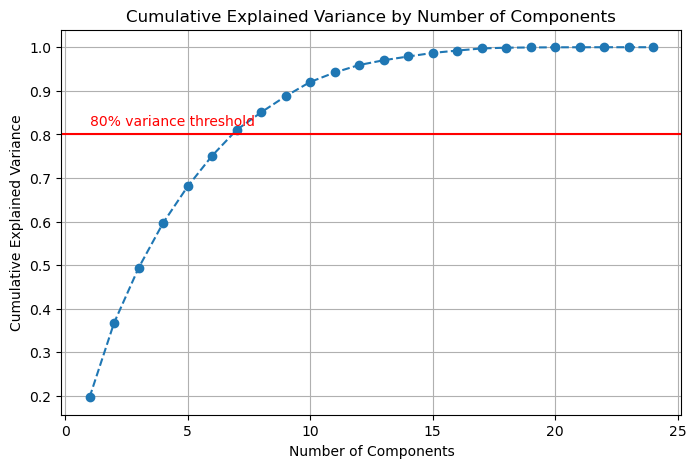

In [65]:
# ---------------------------
# 1. PCA for Variance Analysis (Full PCA)
# ---------------------------
# Fit PCA with a large number of components (e.g., the number of original features)
pca_full = PCA(n_components=X_scaled.shape[1])
pca_full.fit(X_scaled)
# Calculate cumulative explained variance
cumulative_variance = np.cumsum(pca_full.explained_variance_ratio_)
# Print out cumulative variance for each number of components
print("Cumulative Explained Variance:")
for i, var in enumerate(cumulative_variance, start=1):
    print(f"Components 1-{i}: {var:.4f}")

# Plot cumulative explained variance vs. number of components
plt.figure(figsize=(8, 5))
plt.plot(range(1, len(cumulative_variance)+1), cumulative_variance, marker='o', linestyle='--')
plt.title('Cumulative Explained Variance by Number of Components')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.axhline(y=0.8, color='r', linestyle='-')  # For example, a line at 80%
plt.text(1, 0.82, '80% variance threshold', color='red')
plt.grid(True)
plt.show()


In [ ]:
# ============================$$$$$$$$$$$$$$$$$
# 3. PCA for Clustering and Visualization
# ============================
# For clustering: use a higher number of components (e.g., 13) to preserve structure.
pca_clustering = PCA(n_components=8)
X_pca_full = pca_clustering.fit_transform(X_scaled)
print("\nExplained variance ratio (clustering PCA):")
print(pca_clustering.explained_variance_ratio_)

# # For visualization: use PCA with the chosen visualization dimension (2 or 3)
# pca_vis = PCA(n_components=visualization_dim)
# X_pca_vis = pca_vis.fit_transform(X_scaled)
# print("\nExplained variance ratio (visualization PCA):")
# print(pca_vis.explained_variance_ratio_)

# ---------------------------
# Compute Cumulative Explained Variance for both PCA runs
# ---------------------------
# Clustering PCA cumulative variance
# cumulative_variance_clustering = np.cumsum(pca_clustering.explained_variance_ratio_)
# print("\nCumulative explained variance (clustering PCA):")
# for i, var in enumerate(cumulative_variance_clustering, start=1):
#     print(f"Components 1-{i}: {var:.4f}")

# # Visualization PCA cumulative variance
# cumulative_variance_vis = np.cumsum(pca_vis.explained_variance_ratio_)
# print("\nCumulative explained variance (visualization PCA):")
# for i, var in enumerate(cumulative_variance_vis, start=1):
#     print(f"Components 1-{i}: {var:.4f}")


# ---------------------------
# Combine the Cumulative Variance Outputs into a Single DataFrame
# ---------------------------

# df_clustering = pd.DataFrame({
#     "Number of Components": list(range(1, len(cumulative_variance_clustering)+1)),
#     "Cumulative Explained Variance (Clustering PCA)": cumulative_variance_clustering
# })

# df_vis = pd.DataFrame({
#     "Number of Components": list(range(1, len(cumulative_variance_vis)+1)),
#     "Cumulative Explained Variance (Visualization PCA)": cumulative_variance_vis
# })

# # Merge the two DataFrames on "Number of Components"
# df_combined_variance = pd.merge(df_clustering, df_vis, on="Number of Components", how="outer")
# print("\nCombined Cumulative Explained Variance:")
# print(df_combined_variance)

# # Save the combined cumulative explained variance to CSV
# output_csv_path = os.path.join(output_folder, "cumulative_explained_variance.csv")
# df_combined_variance.to_csv(output_csv_path, index=False)
# print("Cumulative explained variance results saved to:", output_csv_path)


Explained variance ratio (clustering PCA):
[0.1969714  0.1707019  0.12599092 0.10309503 0.08370904 0.07056023
 0.05921633 0.04033048]

Cumulative explained variance (clustering PCA):
Components 1-1: 0.1970
Components 1-2: 0.3677
Components 1-3: 0.4937
Components 1-4: 0.5968
Components 1-5: 0.6805
Components 1-6: 0.7510
Components 1-7: 0.8102
Components 1-8: 0.8506


In [67]:
# ---------------------------
# 4. Determine Optimal k using Elbow Method and Silhouette Scores
# ---------------------------

# 4.1 Elbow Method (WCSS)
# ---------------------------
# Parameters for k evaluation
# ---------------------------



# ---------------------------
# Parameters for k evaluation
# ---------------------------
# Option: if you want to run only one value, set only_one_k = True and define k_values accordingly.
only_one_k = True  # Set to True if you want to evaluate only one k value.
if only_one_k:
    k_values = [9]  # Only evaluate k = 10
else:
    k_values = range(2, 15)  # Evaluate k = 2 to 14

# Define the path to save overall evaluation metrics
overall_metrics_csv_path = os.path.join(output_folder, "clustering_evaluation_metrics_overall.csv")

# Create a subfolder to save all K-Means models and trial outputs for different k values
models_folder = os.path.join(output_folder, "kmeans_models")
os.makedirs(models_folder, exist_ok=True)

# Initialize lists to store metrics for each k
metrics_list = []

# Loop over each k value
for k in k_values:
    # Create a subfolder for this specific k
    k_folder = os.path.join(models_folder, f"k_{k}")
    os.makedirs(k_folder, exist_ok=True)
    
    # Fit K-Means and get cluster labels for this trial
    kmeans_temp = KMeans(n_clusters=k, init='k-means++', random_state=42)
    labels_temp = kmeans_temp.fit_predict(X_pca_full)
    
    # Compute evaluation metrics
    sil = silhouette_score(X_pca_full, labels_temp)
    ch = calinski_harabasz_score(X_pca_full, labels_temp)
    wcss_value = kmeans_temp.inertia_
    
    # Append the metrics to the overall list
    metrics_list.append({
        "k": k,
        "Silhouette Score": sil,
        "Calinski-Harabasz Score": ch,
        "WCSS": wcss_value
    })
    
    # Save the K-Means model for this k value
    model_path = os.path.join(k_folder, f"kmeans_model_{k}.pkl")
    joblib.dump(kmeans_temp, model_path)
    print(f"Saved K-Means model for k={k} at {model_path}")
    
    # Save evaluation metrics for this k in a CSV file inside k_folder
    k_metrics_df = pd.DataFrame([{
        "k": k,
        "Silhouette Score": sil,
        "Calinski-Harabasz Score": ch,
        "WCSS": wcss_value
    }])
    k_metrics_csv_path = os.path.join(k_folder, "evaluation_metrics.csv")
    k_metrics_df.to_csv(k_metrics_csv_path, index=False)
    
    # ---------------------------
    # Compute and Save Cluster Composition for this k trial
    # ---------------------------
    # Use label-based indexing to select the rows corresponding to X
    data_subset_trial = data.loc[X.index].copy()
    data_subset_trial['Cluster'] = labels_temp
    # Compute normalized cluster composition: percentage distribution of the original (encoded) labels within each cluster
    cluster_comp_trial = data_subset_trial.groupby('Cluster')['label'].value_counts(normalize=True).unstack(fill_value=0)
    # Save cluster composition to CSV
    comp_csv_path = os.path.join(k_folder, "cluster_composition.csv")
    cluster_comp_trial.to_csv(comp_csv_path)
    print(f"Saved cluster composition for k={k} at {comp_csv_path}")

# After the loop, aggregate and save overall metrics
overall_metrics_df = pd.DataFrame(metrics_list)
overall_metrics_df.to_csv(overall_metrics_csv_path, index=False)
print("Overall clustering evaluation metrics saved as CSV at:", overall_metrics_csv_path)



Saved K-Means model for k=9 at Outputs/k-means/kmeans_run2-5percent/kmeans_models/k_9/kmeans_model_9.pkl
Saved cluster composition for k=9 at Outputs/k-means/kmeans_run2-5percent/kmeans_models/k_9/cluster_composition.csv
Overall clustering evaluation metrics saved as CSV at: Outputs/k-means/kmeans_run2-5percent/clustering_evaluation_metrics_overall.csv


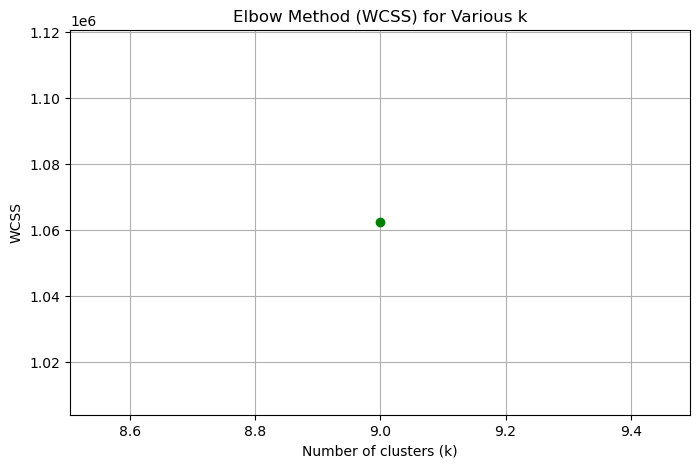

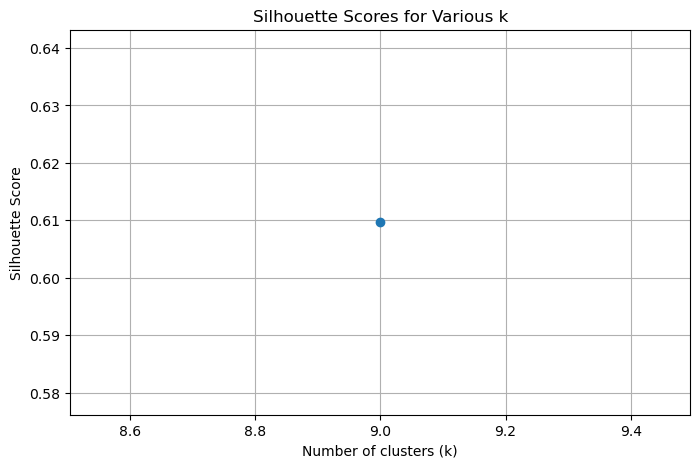

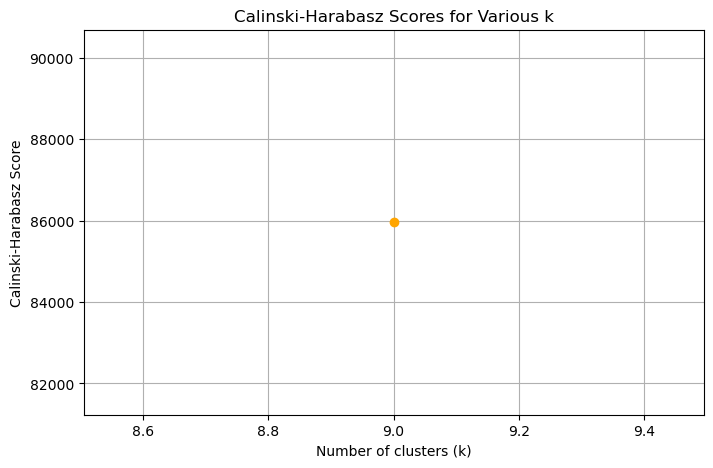


All evaluation outputs (models, metrics, and cluster compositions) saved to: Outputs/k-means/kmeans_run2-5percent


In [68]:
# ---------------------------
# Plot Overall Evaluation Metrics
# ---------------------------
# Plot WCSS (Elbow Method)
plt.figure(figsize=(8, 5))
plt.plot(list(overall_metrics_df["k"]), overall_metrics_df["WCSS"], marker='o', linestyle='--', color='green')
plt.title("Elbow Method (WCSS) for Various k")
plt.xlabel("Number of clusters (k)")
plt.ylabel("WCSS")
plt.grid(True)
wcss_plot_path = os.path.join(output_folder, "wcss.png")
plt.savefig(wcss_plot_path, bbox_inches='tight')
plt.show()

# Plot Silhouette Scores
plt.figure(figsize=(8, 5))
plt.plot(list(overall_metrics_df["k"]), overall_metrics_df["Silhouette Score"], marker='o', linestyle='--')
plt.title("Silhouette Scores for Various k")
plt.xlabel("Number of clusters (k)")
plt.ylabel("Silhouette Score")
plt.grid(True)
sil_plot_path = os.path.join(output_folder, "silhouette_scores.png")
plt.savefig(sil_plot_path, bbox_inches='tight')
plt.show()

# Plot Calinski-Harabasz Scores
plt.figure(figsize=(8, 5))
plt.plot(list(overall_metrics_df["k"]), overall_metrics_df["Calinski-Harabasz Score"], marker='o', linestyle='--', color='orange')
plt.title("Calinski-Harabasz Scores for Various k")
plt.xlabel("Number of clusters (k)")
plt.ylabel("Calinski-Harabasz Score")
plt.grid(True)
ch_plot_path = os.path.join(output_folder, "calinski_harabasz_scores.png")
plt.savefig(ch_plot_path, bbox_inches='tight')
plt.show()

print("\nAll evaluation outputs (models, metrics, and cluster compositions) saved to:", output_folder)

In [42]:
# ============================ $$$$$$$$$$$$$$$$$
# 5. Run K-Means Clustering with Chosen k
# ============================


# Set the chosen number of clusters (optimal k) from your evaluation
optimal_clusters = 10

kmeans = KMeans(n_clusters=optimal_clusters, init='k-means++', random_state=42)
cluster_labels = kmeans.fit_predict(X_pca_full)

In [47]:
# ---------------------------
# Dynamically Encode the Labels and Create a Mapping
# ---------------------------
# Factorize the label column to automatically assign integer labels.
# Dynamically encode the labels using factorize and create a mapping
data['label'], uniques = pd.factorize(data['label'])
label_names = {i: label for i, label in enumerate(uniques)}

print("Encoded labels mapping:")
print(label_names)

# Save the label mapping as CSV for future reference
label_mapping_df = pd.DataFrame(list(label_names.items()), columns=["Encoded Label", "Original Label"])
label_mapping_csv_path = os.path.join(output_folder, "label_mapping.csv")
label_mapping_df.to_csv(label_mapping_csv_path, index=False)
print("Label mapping saved as CSV:", label_mapping_csv_path)


# ============================
# 6. Align Clusters with Original Labels (for Classification Insight)
# ============================
# 6.1] Use label-based indexing to match rows from original data (X) with cluster results.
data_subset = data.loc[X.index].copy()
data_subset['Cluster'] = cluster_labels

def align_clusters(data_subset, label_names):
    # Map clusters to their majority label using the 'label' column
    cluster_mapping = (
        data_subset.groupby('Cluster')['label']
        .apply(lambda x: x.value_counts().idxmax())
        .to_dict()
    )
    # Create human-readable mapping from cluster numbers to original label names
    cluster_label_mapping = {cluster: label_names[true_label] for cluster, true_label in cluster_mapping.items()}
    # Create additional columns for clarity
    data_subset['Mapped Label'] = data_subset['label'].map(label_names)
    data_subset['Aligned Cluster'] = data_subset['Cluster'].map(cluster_mapping)
    return cluster_mapping, cluster_label_mapping, data_subset



Encoded labels mapping:
{0: 0, 1: 1, 2: 2, 3: 3, 4: 4, 5: 5, 6: 6, 7: 7}
Label mapping saved as CSV: Outputs/k-means/kmeans_run1/label_mapping.csv


In [48]:
# 6.2
normal_mapping, normal_label_mapping, data_normal = align_clusters(data_subset, label_names)
print("\nCluster Mapping (Aligned to Majority Labels):")
print(normal_label_mapping)

cluster_composition_normal = (
    data_normal.groupby('Cluster')['Mapped Label']
    .value_counts(normalize=True)
    .unstack(fill_value=0)
)
print("\nCluster Composition (Normalized):")
print(cluster_composition_normal)

# Save cluster alignment outputs as CSV
cluster_composition_normal.to_csv(os.path.join(output_folder, "cluster_composition.csv"), index=True)
pd.DataFrame(list(normal_label_mapping.items()), columns=["Cluster", "Mapped Label"]).to_csv(
    os.path.join(output_folder, "cluster_mapping.csv"), index=False)
data_normal.to_csv(os.path.join(output_folder, "data_with_clusters.csv"), index=False)
print("Cluster composition, mapping, and data with clusters saved as CSV.")


Cluster Mapping (Aligned to Majority Labels):
{0: 0, 1: 2, 2: 0, 3: 0, 4: 3, 5: 2, 6: 7, 7: 0, 8: 0, 9: 0}

Cluster Composition (Normalized):
Mapped Label         0         1         2         3         4         5  \
Cluster                                                                    
0             0.999756  0.000000  0.000066  0.000000  0.000000  0.000000   
1             0.390187  0.000029  0.584978  0.000000  0.000000  0.021381   
2             1.000000  0.000000  0.000000  0.000000  0.000000  0.000000   
3             0.965002  0.006452  0.000265  0.000000  0.000000  0.000619   
4             0.024265  0.389093  0.000000  0.461977  0.124665  0.000000   
5             0.014220  0.000000  0.935394  0.000000  0.000000  0.030344   
6             0.000000  0.000000  0.336066  0.000000  0.000000  0.000000   
7             0.991617  0.000000  0.000000  0.000000  0.000000  0.000000   
8             0.697414  0.032900  0.000000  0.229025  0.000000  0.040578   
9             1.00000

In [56]:
# ============================
# 7. Visualization of Clusters
# ============================
import plotly.express as px

# Set the visualization dimension directly here:
# Set visualization dimension (2 for 2D, 3 for 3D)
visualization_dim = 3  
# Recompute the visualization PCA using the chosen dimension
pca_vis = PCA(n_components=visualization_dim)
X_pca_vis = pca_vis.fit_transform(X_scaled)
print("\nExplained variance ratio (visualization PCA):")
print(pca_vis.explained_variance_ratio_)

# For 2D Visualization Data
if visualization_dim == 2:
    # Create a DataFrame with the 2D PCA coordinates and cluster labels
    df_vis2d = pd.DataFrame(X_pca_vis, columns=["PC1", "PC2"])
    df_vis2d["Cluster"] = cluster_labels
    # Save to CSV
    vis2d_csv_path = os.path.join(output_folder, "visualization_2D_data.csv")
    df_vis2d.to_csv(vis2d_csv_path, index=False)
    print("2D visualization data saved as CSV:", vis2d_csv_path)
    
    # ---------------------------
    # Interactive 2D Visualization with Plotly
    # ---------------------------
    fig = px.scatter(df_vis2d, x='PC1', y='PC2',
                     color='Cluster', title="Interactive 2D Visualization of Clusters")
    fig.show()
    
    # Save interactive plot as HTML
    plotly_html_path = os.path.join(output_folder, "interactive_clusters_2D.html")
    fig.write_html(plotly_html_path)
    print("Interactive 2D plot saved as HTML:", plotly_html_path)
    
    # Save interactive plot as PNG (requires kaleido)
    plotly_png_path = os.path.join(output_folder, "interactive_clusters_2D.png")
    fig.write_image(plotly_png_path, scale=2)
    print("Interactive 2D plot saved as PNG:", plotly_png_path)

elif visualization_dim == 3:
    # Create a DataFrame with the 3D PCA coordinates and cluster labels
    df_vis3d = pd.DataFrame(X_pca_vis, columns=["PC1", "PC2", "PC3"])
    df_vis3d["Cluster"] = cluster_labels
    # Save to CSV
    vis3d_csv_path = os.path.join(output_folder, "visualization_3D_data.csv")
    df_vis3d.to_csv(vis3d_csv_path, index=False)
    print("3D visualization data saved as CSV:", vis3d_csv_path)
    
    # ---------------------------
    # Interactive 3D Visualization with Plotly
    # ---------------------------
    fig = px.scatter_3d(df_vis3d, x='PC1', y='PC2', z='PC3',
                        color='Cluster', title="Interactive 3D Visualization of Clusters")
    fig.show()
    
    # Save interactive plot as HTML
    plotly_html_path = os.path.join(output_folder, "interactive_clusters_3D.html")
    fig.write_html(plotly_html_path)
    print("Interactive 3D plot saved as HTML:", plotly_html_path)
    
    # Save interactive plot as PNG (requires kaleido)
    plotly_png_path = os.path.join(output_folder, "interactive_clusters_3D.png")
    fig.write_image(plotly_png_path, scale=2)
    print("Interactive 3D plot saved as PNG:", plotly_png_path)
else:
    print("Visualization dimension not supported.")


Explained variance ratio (visualization PCA):
[0.1969714  0.1707019  0.12599092]
3D visualization data saved as CSV: Outputs/k-means/kmeans_run1/visualization_3D_data.csv


Interactive 3D plot saved as HTML: Outputs/k-means/kmeans_run1/interactive_clusters_3D.html
Interactive 3D plot saved as PNG: Outputs/k-means/kmeans_run1/interactive_clusters_3D.png


In [54]:
# ============================
# 8. Save Models and Preprocessing Artifacts
# ============================
joblib.dump(pca_full, os.path.join(output_folder, "pca_full_model.pkl"))
joblib.dump(pca_clustering, os.path.join(output_folder, "pca_clustering_model.pkl"))
joblib.dump(pca_vis, os.path.join(output_folder, "pca_visualization_model.pkl"))
joblib.dump(kmeans, os.path.join(output_folder, "kmeans_model.pkl"))
joblib.dump(scaler, os.path.join(output_folder, "scaler.pkl"))
print("PCA models, K-Means model, and scaler saved.")

# ---------------------------
# Save Additional Evaluation Plots and Metrics
# ---------------------------
# Save PCA explained variance ratio to a text file
with open(os.path.join(output_folder, "pca_explained_variance.txt"), "w") as f:
    f.write("Explained Variance Ratio (Full PCA):\n")
    f.write(str(pca_full.explained_variance_ratio_))
print("PCA explained variance ratio saved.")

# Save Elbow Method plot as PNG (already plotted above, now re-save)
elbow_plot_path = os.path.join(output_folder, "elbow_method.png")
plt.figure(figsize=(8, 5))
plt.plot(range(1, len(wcss) + 1), wcss, marker='o', linestyle='--')
plt.title('Elbow Method for Optimal k')
plt.xlabel('Number of clusters')
plt.ylabel('WCSS')
plt.grid(True)
plt.tight_layout()
plt.savefig(elbow_plot_path)
plt.close()
print("Elbow Method plot saved.")

# Save silhouette and Calinski-Harabasz scores as CSV (already saved above in metrics_df)
# (This was saved as clustering_evaluation_metrics.csv)

print("\nAll outputs saved to:", output_folder)

PCA models, K-Means model, and scaler saved.
PCA explained variance ratio saved.
Elbow Method plot saved.

All outputs saved to: Outputs/k-means/kmeans_run1
